In [ ]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

np.random.seed(42)

## Hyperparameters and Constants

Here, I define wether to train the model or not and for how many epochs to train for.

If `TRAIN = False`, then the last trained model will be used for inference in the notebook if run end to end.

In [ ]:
TRAIN = True

## Download and Prepare the Dataset

I will use a <a href="https://app.roboflow.com/ds/ReliRzR2PO?key=INYILG4hU7" target="_blank">dataset of fruits</a> that I have previouly labeled and preprocessed using CVAT and Roboflow. It has 300 images with apples, bananas and oranges labelled. This dataset will be used for training the custom YOLOv5 object detector. Original dataset is located in <a href="https://www.kaggle.com/datasets/mbkinaci/fruit-images-for-object-detection" target="_blank">Kaggle</a>.



Let's download the dataset.

In [ ]:
if not os.path.exists('train'):
    !curl -L "https://app.roboflow.com/ds/ReliRzR2PO?key=INYILG4hU7" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   2495      0 --:--:-- --:--:-- --:--:--  2488
100 5028k  100 5028k    0     0  9707k      0 --:--:-- --:--:-- --:--:-- 9707k
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: train/
   creating: train/images/
 extracting: train/images/apple_11_jpg.rf.fe63cdcbfb1ceb8facb2fefe75785155.jpg  
 extracting: train/images/apple_12_jpg.rf.86d95b95b0a9cba61028a4a85c64ed75.jpg  
 extracting: train/images/apple_13_jpg.rf.982a1e46868b8405b43ffbc4ba13dbc6.jpg  
 extracting: train/images/apple_15_jpg.rf.d98ecd9d345554a744cd35f7a13a584a.jpg  
 extracting: train/images/apple_16_jpg.rf.e888464eb815d457a79abd62e7e8d8a5.jpg  
 extracting: train/images/apple_17_jpg.rf.fbfdbf7249ea111200469cf659fdc66e.jpg  
 extracting: t

I will use <a href="https://github.com/javier-marti-isasi/YOLOv5m-training-using-finetuning-and-data-augmentation-on-a-custom-labeled-dataset/tree/main/inference" target="_blank">these images</a> as inference data. I locate them in a new folder called "inference".

The dataset is structured in the following manner:

```
├── data.yaml
├── README.dataset.txt
├── README.roboflow.txt
├── inference
├── train
│   ├── images
│   └── labels
└── valid
    ├── images
    └── labels

```

## Helper Functions to Download Files

### The Dataset YAML File

The dataset YAML (`data.yaml`) file containing the path to the training and validation images and labels is already provided. This file will also contain the class names from the dataset.

The dataset contains 3 classes: **'applerotation', 'bananarotation', 'orangerotation'**.

The following block shows the contents of the `data.yaml` file (names have been manually adjusted).

```yaml
train: ../train/images
val: ../valid/images

nc: 3
names: ['apple', 'banana', 'orange']
```

### Visualize a Few Ground Truth Images

Before moving forward, let's check out few of the ground truth images. 

The current annotations in the text files are in normalized `[x_center, y_center, width, height]` format. Let's write a function that will convert it back to `[x_min, y_min, x_max, y_max]` format.

In [ ]:
class_names = ['apple', 'banana', 'orange']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin
        
        class_name = class_names[int(labels[box_num])]
        
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        ) 

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))
        
        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name, 
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image, 
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image, 
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [ ]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()
    
    num_images = len(all_training_images)
    
    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

In [ ]:
# Visualize a few training images.
plot(
    image_paths='train/images/*', 
    label_paths='train/labels/*',
    num_samples=4,
)

## Helper Functions for Logging

Here, I write the helper functions that we need for logging of the results in the notebook while training the models.

Let's create our custom result directories so that we can easily keep track of them and carry out inference using the proper model.

In [ ]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

Function to Monitor TensorBoard logs:

In [ ]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

## Clone YOLOV5 Repository

In [ ]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 12446, done.
remote: Counting objects: 100% (46/46), done.
remote: Compressing objects: 100% (41/41), done.
remote: Total 12446 (delta 23), reused 15 (delta 5), pack-reused 12400
Receiving objects: 100% (12446/12446), 12.45 MiB | 30.06 MiB/s, done.
Resolving deltas: 100% (8523/8523), done.


In [ ]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 596 kB 7.6 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


We start tensorboard to monitor the model performance.

In [ ]:
monitor_tensorboard()

## Check Out the Validation Predictions and Inference

In this section, there are the functions used to check out the predictions of the validation images saved during training. Along with that, we will also check out inference of test images.

### Visualization and Inference Utilities

We will visualize the validation prediction images that are saved during training. The following is the function for that.

In [ ]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

The following functions are for carrying out inference on images.

In [ ]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

We may also need to visualize images in any of the directories. The following function accepts a directory path and plots all the images in them. 

In [ ]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

# Experiments

In this section, I provide sevaral experiements combining finetuning and data augmentation techniques.

For these experiments I used the Medium model (yolov5m). It contains 25 blocks layers in total more than 20 million parameters. We don't need to train all the layers. In these experiments we will freeze a few layers and train again. This will result in faster iteration per epoch.

## Experiment 1: Finetuning yolov5m (nº frozen layers=18)

### Training

Here, we freeze the first 18 blocks.

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 416 --epochs 500 --batch-size 16 --name {RES_DIR} \
    --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17

Current number of result directories: 1
results_2
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=500, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_2, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-357-ga75a110 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05,

In [ ]:
monitor_tensorboard()

### Visualize validation prediction images

In [ ]:
show_valid_results(RES_DIR)

### Inference on Images

In this section, we will carry out inference on the unseen images. 

To carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, '../inference')

Current number of inference detection directories: 1
inference_2
detect: weights=['runs/train/results_2/weights/best.pt'], source=../inference, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_2, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-357-ga75a110 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 290 layers, 20861016 parameters, 0 gradients, 47.9 GFLOPs
image 1/8 /content/inference/apple_test_01.jpg: 512x640 3 apples, Done. (0.023s)
image 2/8 /content/inference/apple_test_02.jpg: 544x640 1 apple, Done. (0.026s)
image 3/8 /content/inference/banana_test_01.jpg: 544x640 1 banana, Done. (0.026s)
image 4/8 /content/inference/banana_test_02.

['runs/detect/inference_2/apple_test_02.jpg', 'runs/detect/inference_2/mix_test_01.jpg', 'runs/detect/inference_2/banana_test_01.jpg', 'runs/detect/inference_2/banana_test_02.jpg', 'runs/detect/inference_2/orange_test_01.jpg', 'runs/detect/inference_2/mix_test_02.jpg', 'runs/detect/inference_2/orange_test_02.jpg', 'runs/detect/inference_2/apple_test_01.jpg']


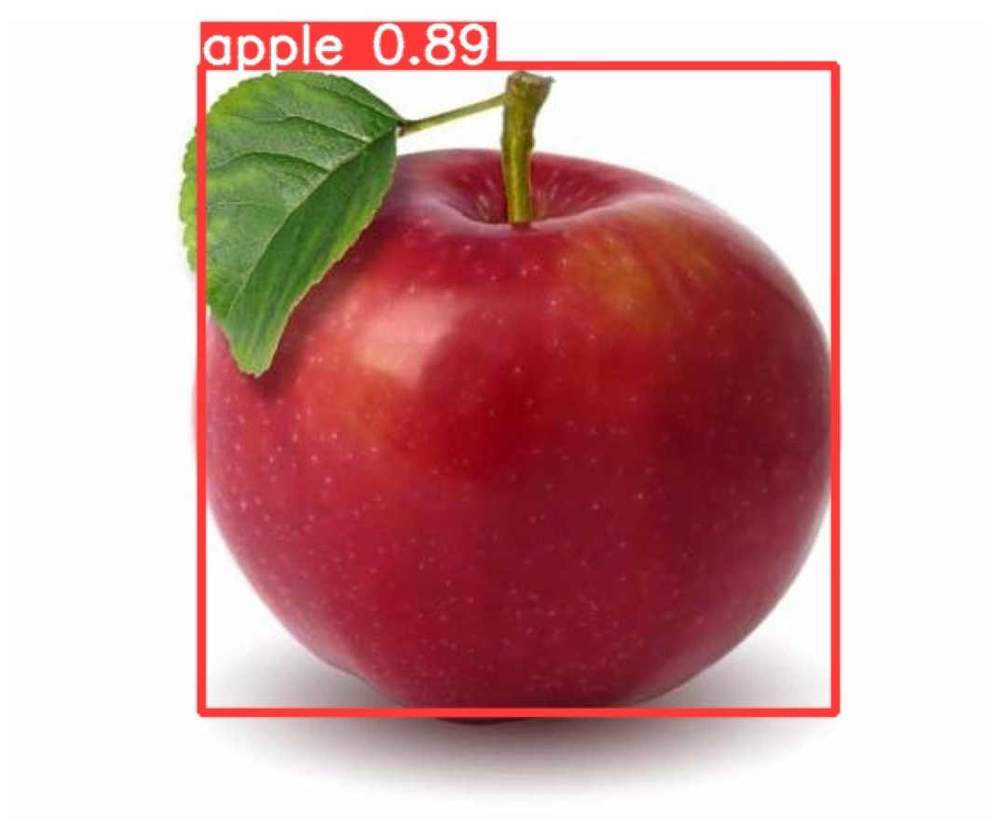

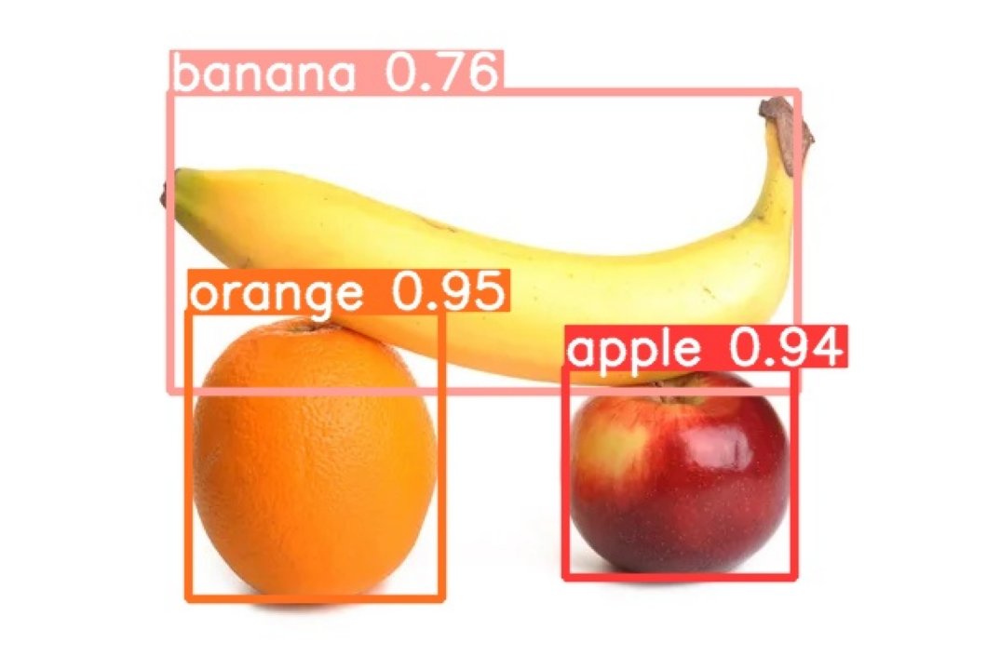

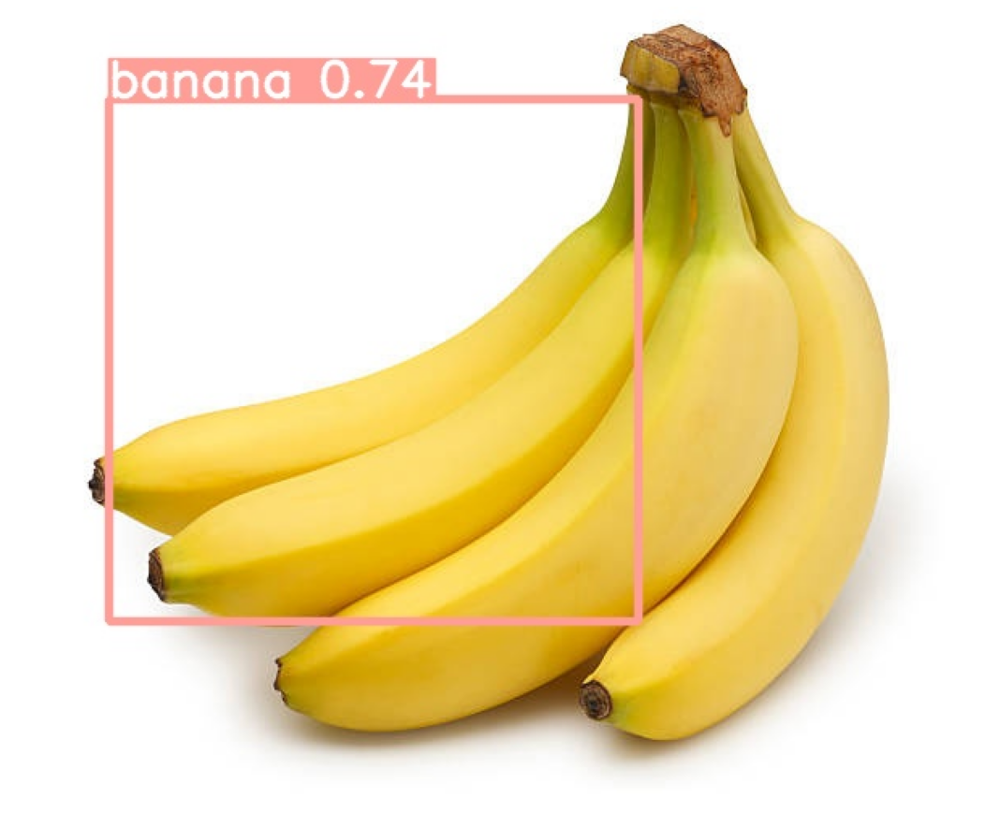

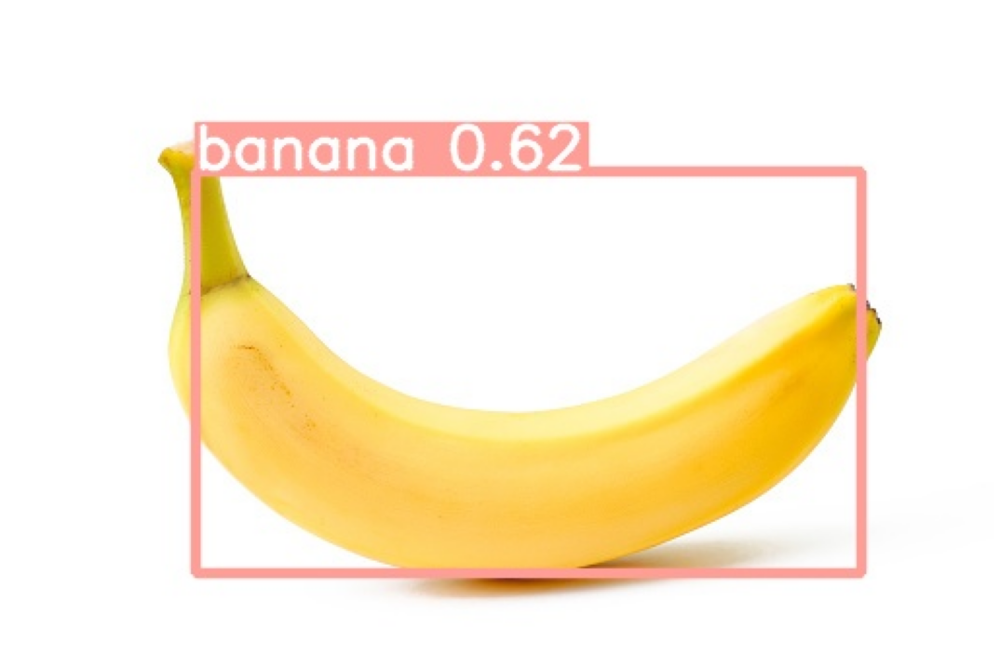

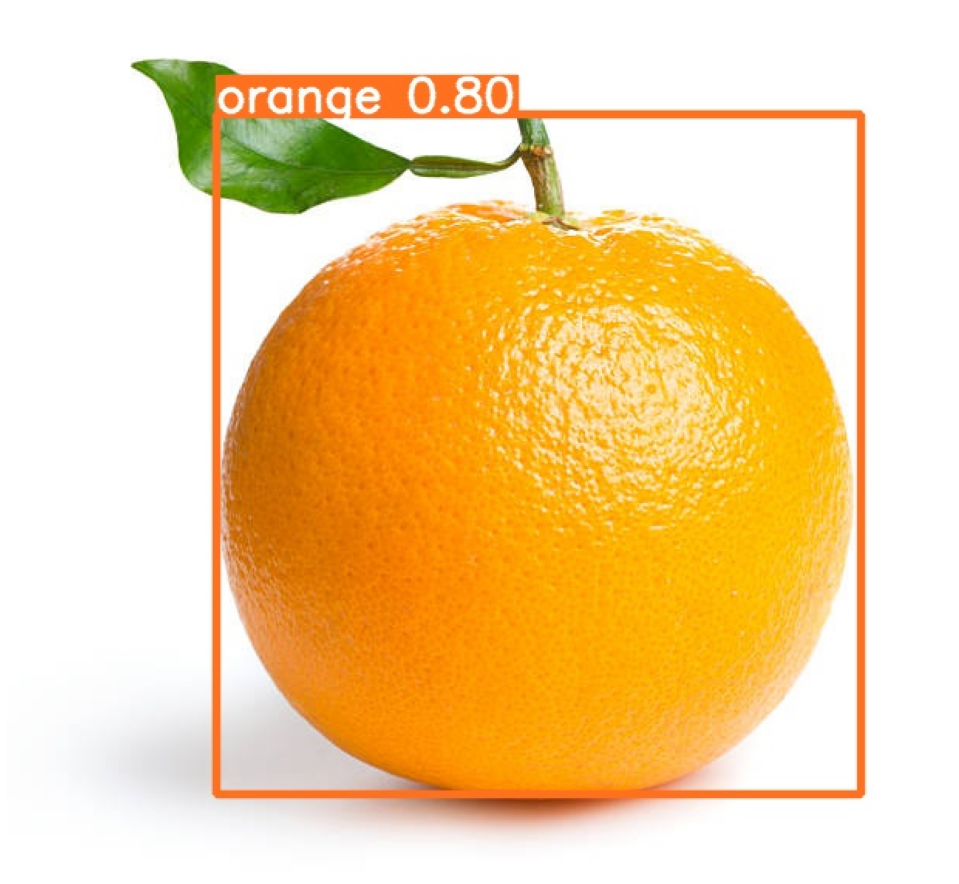

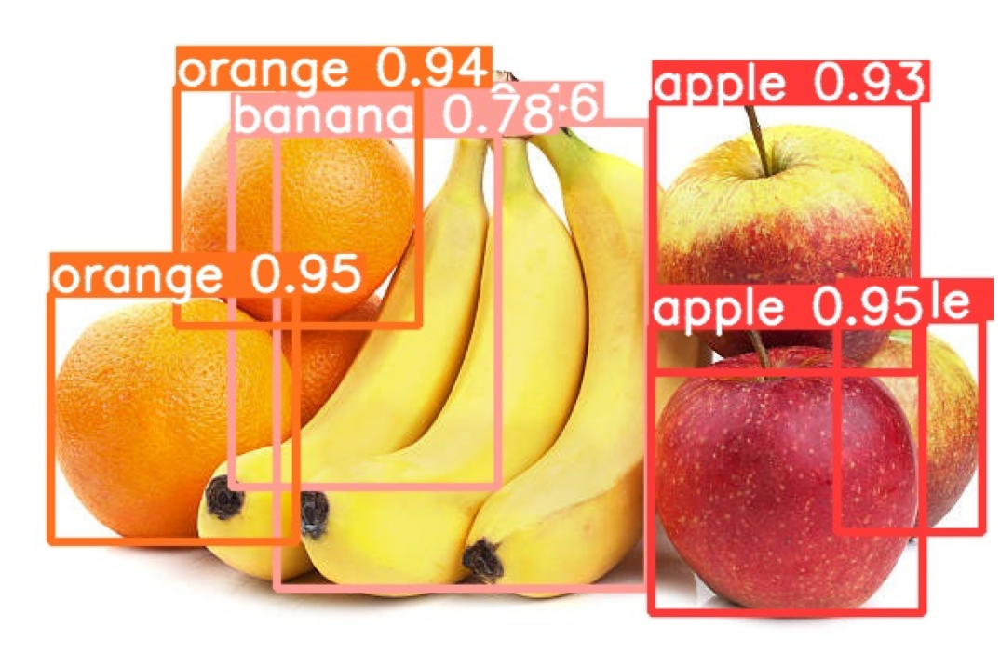

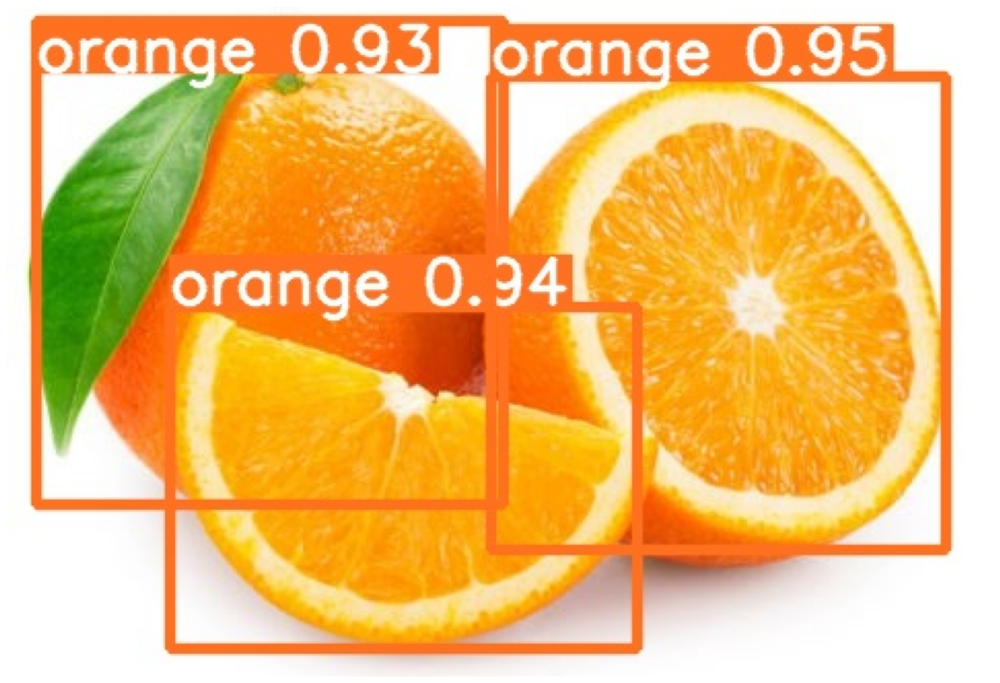

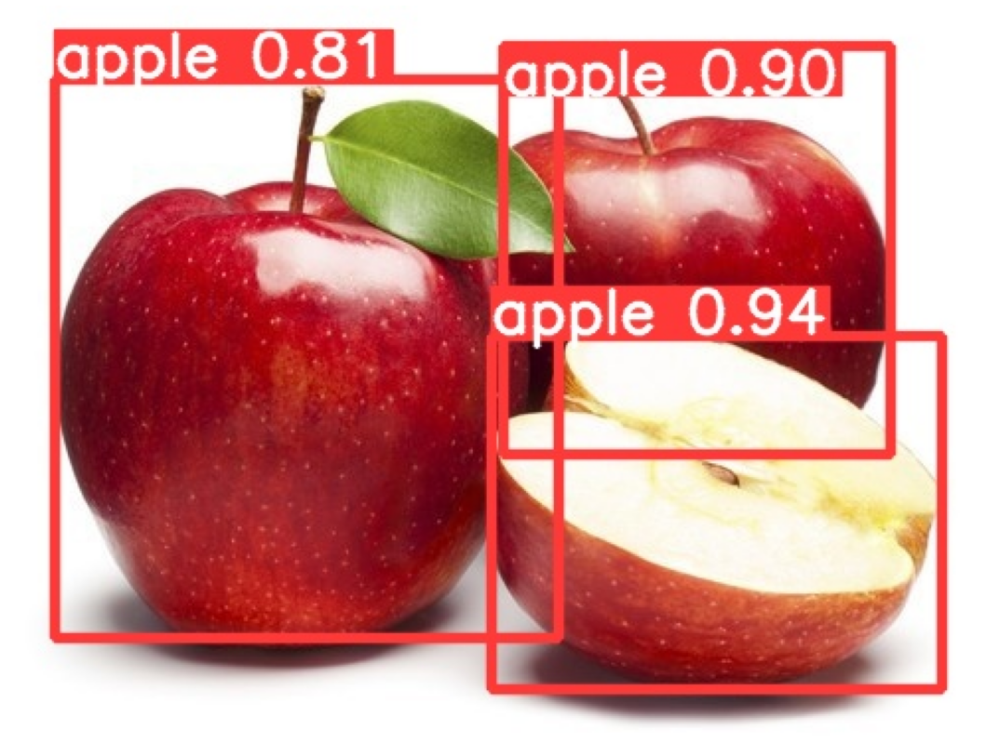

In [ ]:
visualize(IMAGE_INFER_DIR)

## Experiment 2: Finetuning yolov5m (nº frozen layers=15)

### Training

Here, we freeze the first 15 blocks.

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 416 --epochs 500 --batch-size 16 --name {RES_DIR} \
    --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

Current number of result directories: 0
results_1
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=500, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-357-ga75a110 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cl

In [ ]:
monitor_tensorboard()

### Visualize validation prediction images

In [ ]:
show_valid_results(RES_DIR)

### Inference on Images

In this section, we will carry out inference on the unseen images. 

To carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, '../inference')

Current number of inference detection directories: 2
inference_3
detect: weights=['runs/train/results_1/weights/best.pt'], source=../inference, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_3, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-357-ga75a110 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 290 layers, 20861016 parameters, 0 gradients, 47.9 GFLOPs
image 1/8 /content/inference/apple_test_01.jpg: 512x640 3 apples, Done. (0.023s)
image 2/8 /content/inference/apple_test_02.jpg: 544x640 1 apple, Done. (0.026s)
image 3/8 /content/inference/banana_test_01.jpg: 544x640 3 bananas, Done. (0.025s)
image 4/8 /content/inference/banana_test_02

['runs/detect/inference_3/apple_test_02.jpg', 'runs/detect/inference_3/mix_test_01.jpg', 'runs/detect/inference_3/banana_test_01.jpg', 'runs/detect/inference_3/banana_test_02.jpg', 'runs/detect/inference_3/orange_test_01.jpg', 'runs/detect/inference_3/mix_test_02.jpg', 'runs/detect/inference_3/orange_test_02.jpg', 'runs/detect/inference_3/apple_test_01.jpg']


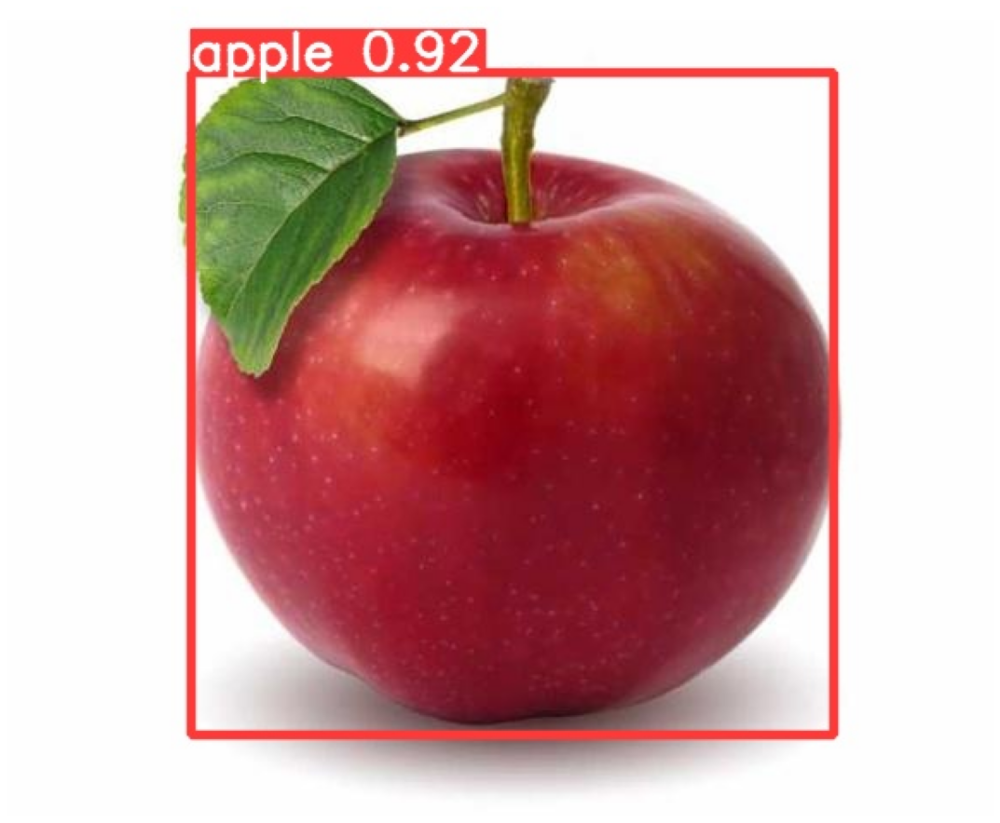

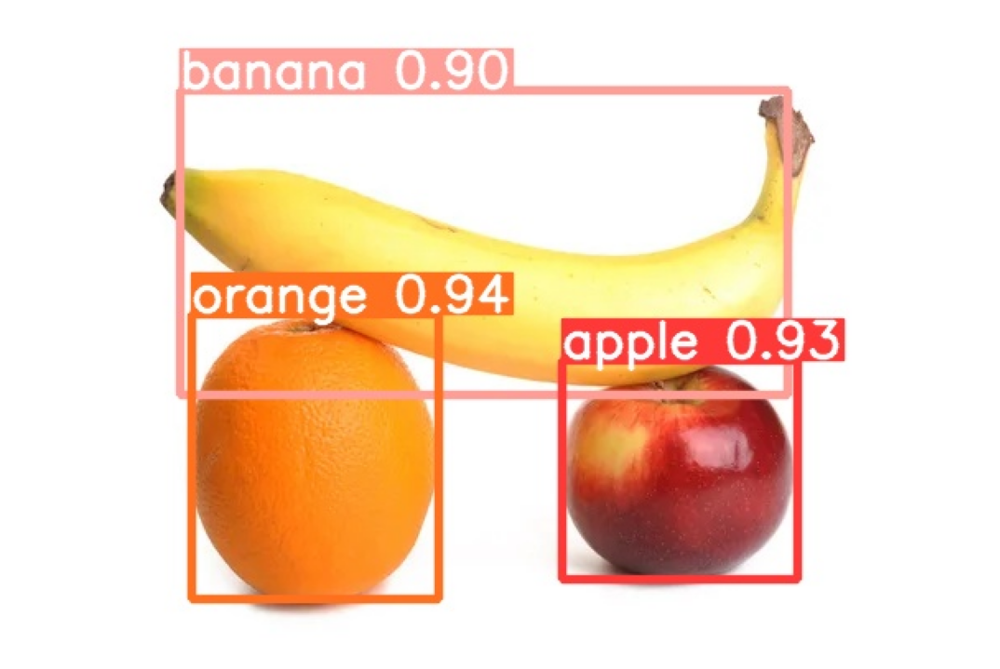

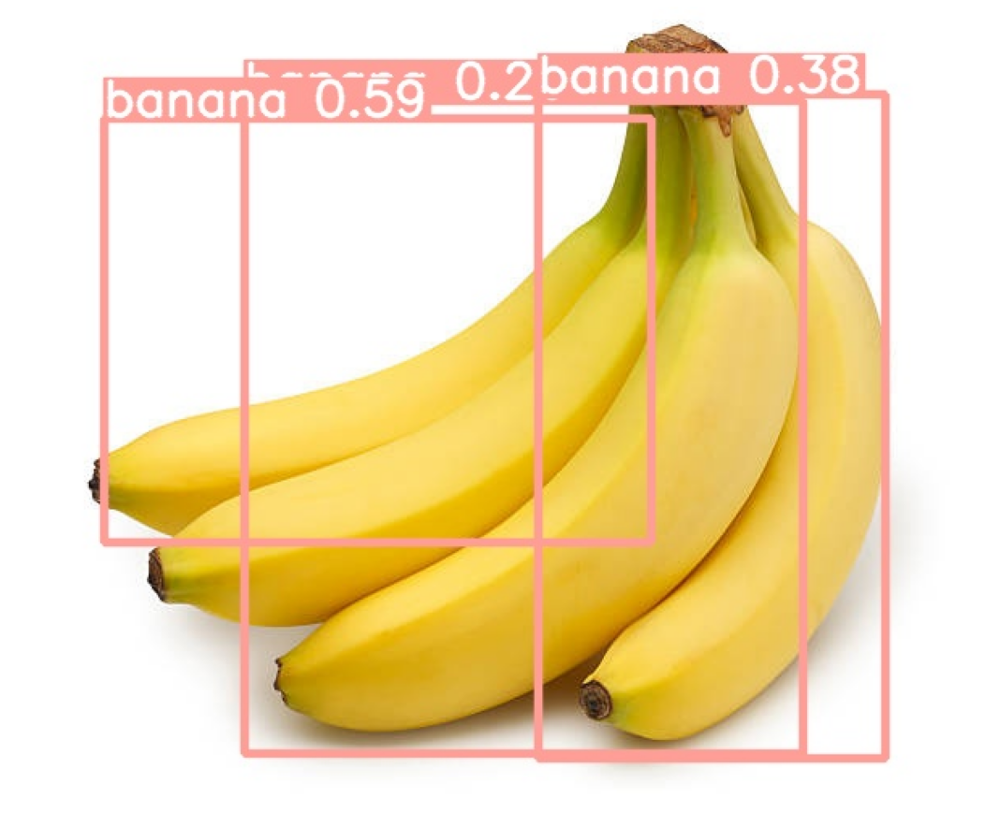

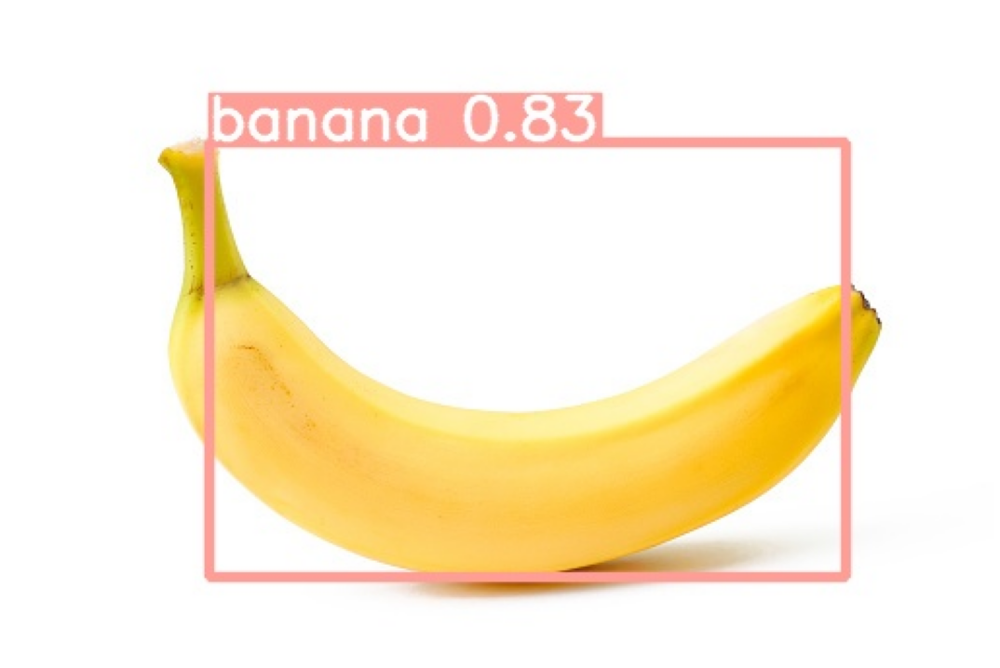

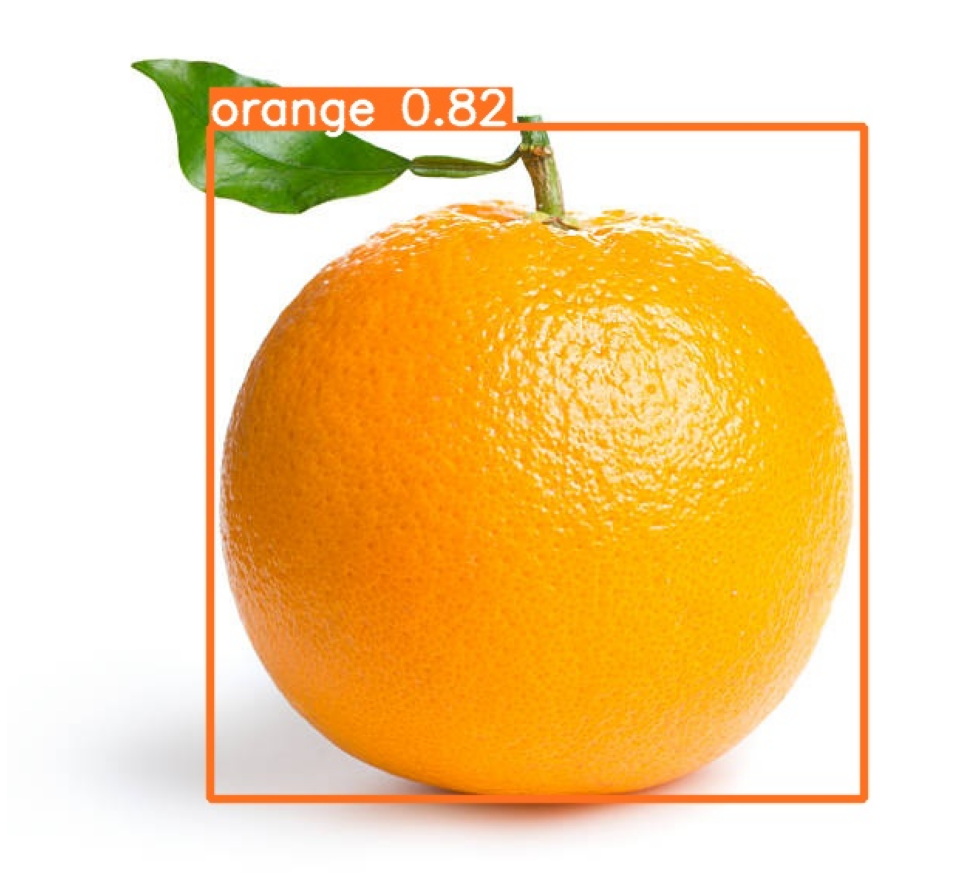

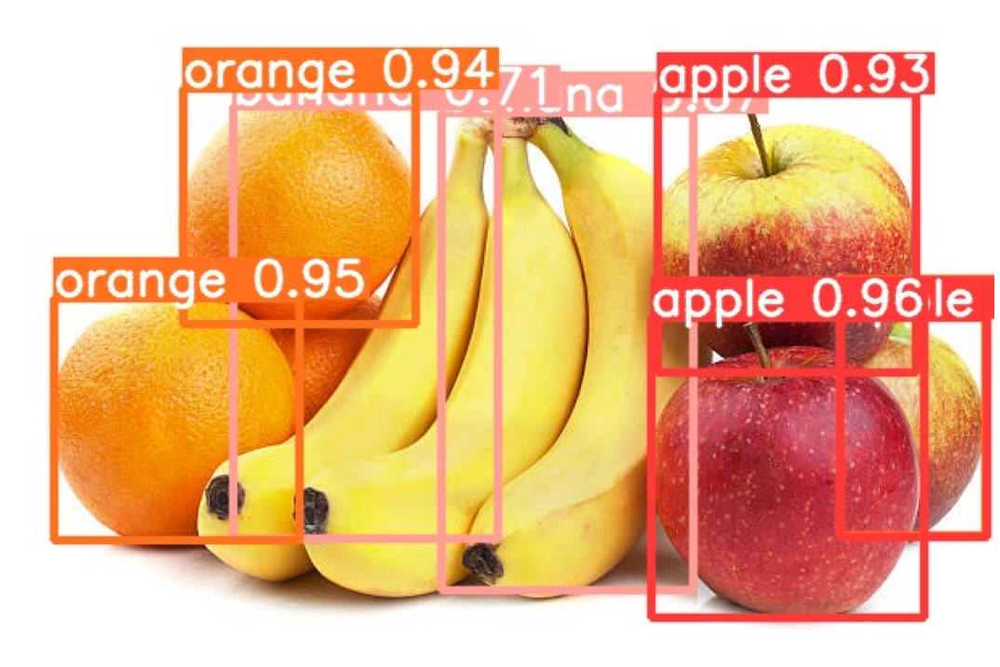

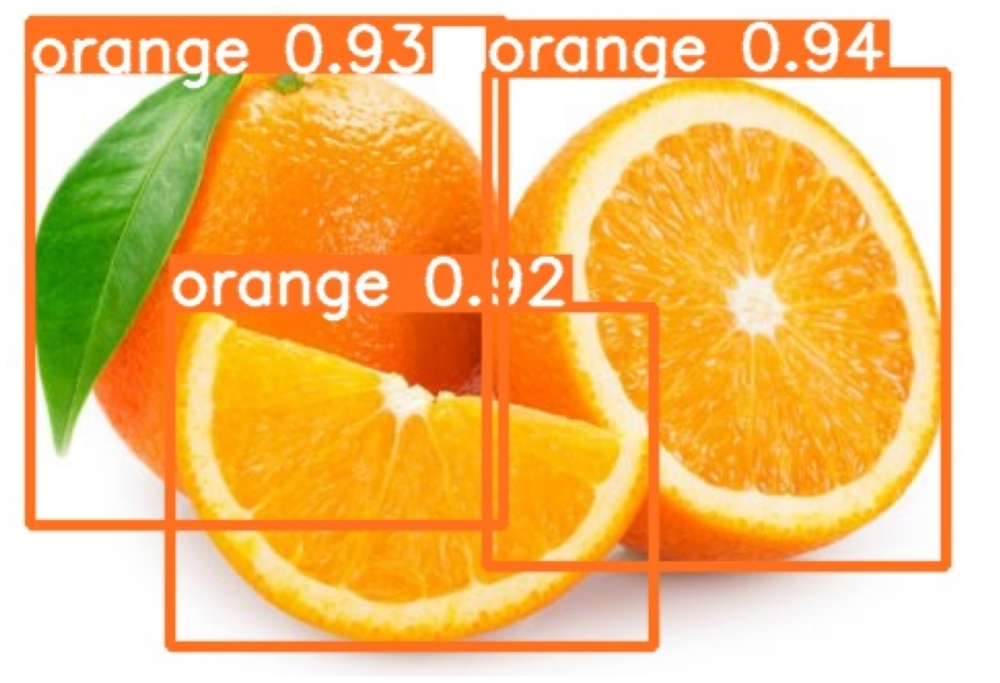

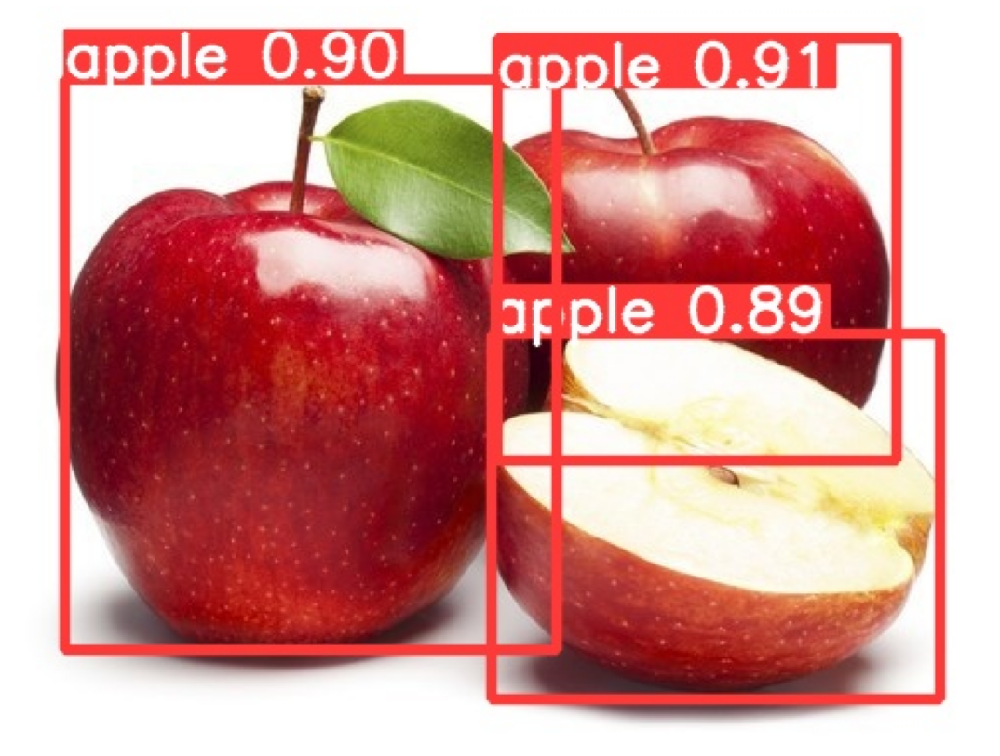

In [ ]:
visualize(IMAGE_INFER_DIR)

## Experiment 3: Data Augmentation + Finetuning yolo5m (nº frozen layers=15)

### Download and Prepare the Dataset

In this experiment, I used <a href="https://app.roboflow.com/ds/w115d8mw7V?key=H7V9pu9bcS" target="_blank">Augmented Fruits</a>: the aumented version of the fruits dataset. Data Augmentation was generated in Roboflow with these specifications:
- Outputs per training example: 3
- Crop: 0% Minimum Zoom, 20% Maximum Zoom
- Rotation: Between -15° and +15°

First, I delete the previous dataset.

In [ ]:
!pwd

/content/yolov5


In [ ]:
%cd /content

!rm -rf train
!rm -rf valid
!rm -rf README.dataset.txt
!rm -rf README.roboflow.txt
!rm -rf data.yaml

/content


Let's download the augmented dataset.

In [ ]:
%cd /content

if not os.path.exists('train'):
    !curl -L "https://app.roboflow.com/ds/w115d8mw7V?key=H7V9pu9bcS" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

%cd /content/yolov5

/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   2673      0 --:--:-- --:--:-- --:--:--  2673
100 13.1M  100 13.1M    0     0  22.9M      0 --:--:-- --:--:-- --:--:-- 22.9M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: train/
   creating: train/images/
 extracting: train/images/apple_11_jpg.rf.379739872c8f9e35a81dfcefc1f4a84a.jpg  
 extracting: train/images/apple_11_jpg.rf.59fb457631d3c48cbaad7840e3da20f6.jpg  
 extracting: train/images/apple_11_jpg.rf.cab4574786bb41b5ae70944bb8c9754b.jpg  
 extracting: train/images/apple_12_jpg.rf.1e0345b4ef74d898b2d36463c3c3b934.jpg  
 extracting: train/images/apple_12_jpg.rf.35fa2af253f03140e441b5c93ed47382.jpg  
 extracting: train/images/apple_12_jpg.rf.48d5912797b41313296268086e9b3915.jpg  
 extr

The dataset is structured in the following manner:

```
├── data.yaml
├── README.dataset.txt
├── README.roboflow.txt
├── test
│   └── images
├── train
│   ├── images
│   └── labels
└── valid
    ├── images
    └── labels

```

### Training

Here, we freeze the first 15 blocks.

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 416 --epochs 500 --batch-size 16 --name {RES_DIR} \
    --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

Current number of result directories: 0
results_1
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=500, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-359-g628c05c Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cl

In [ ]:
monitor_tensorboard()

### Visualize validation prediction images

In [ ]:
show_valid_results(RES_DIR)

### Inference on Images

In this section, we will carry out inference on the unseen images. 

To carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, '../inference')

Current number of inference detection directories: 0
inference_1
detect: weights=['runs/train/results_1/weights/best.pt'], source=../inference, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_1, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-359-g628c05c Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 290 layers, 20861016 parameters, 0 gradients, 47.9 GFLOPs
image 1/8 /content/inference/apple_test_01.jpg: 512x640 3 apples, Done. (0.023s)
image 2/8 /content/inference/apple_test_02.jpg: 544x640 1 apple, Done. (0.026s)
image 3/8 /content/inference/banana_test_01.jpg: 544x640 2 bananas, Done. (0.026s)
image 4/8 /content/inference/banana_test_02

['runs/detect/inference_1/apple_test_02.jpg', 'runs/detect/inference_1/mix_test_01.jpg', 'runs/detect/inference_1/banana_test_01.jpg', 'runs/detect/inference_1/banana_test_02.jpg', 'runs/detect/inference_1/orange_test_01.jpg', 'runs/detect/inference_1/mix_test_02.jpg', 'runs/detect/inference_1/orange_test_02.jpg', 'runs/detect/inference_1/apple_test_01.jpg']


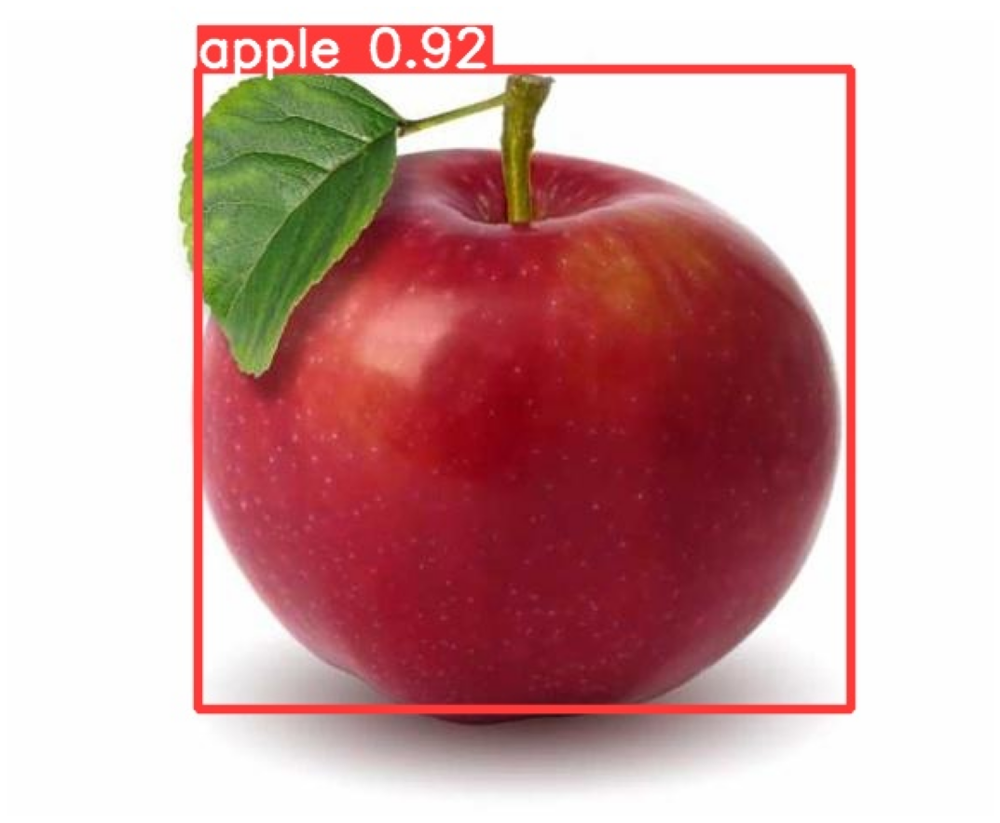

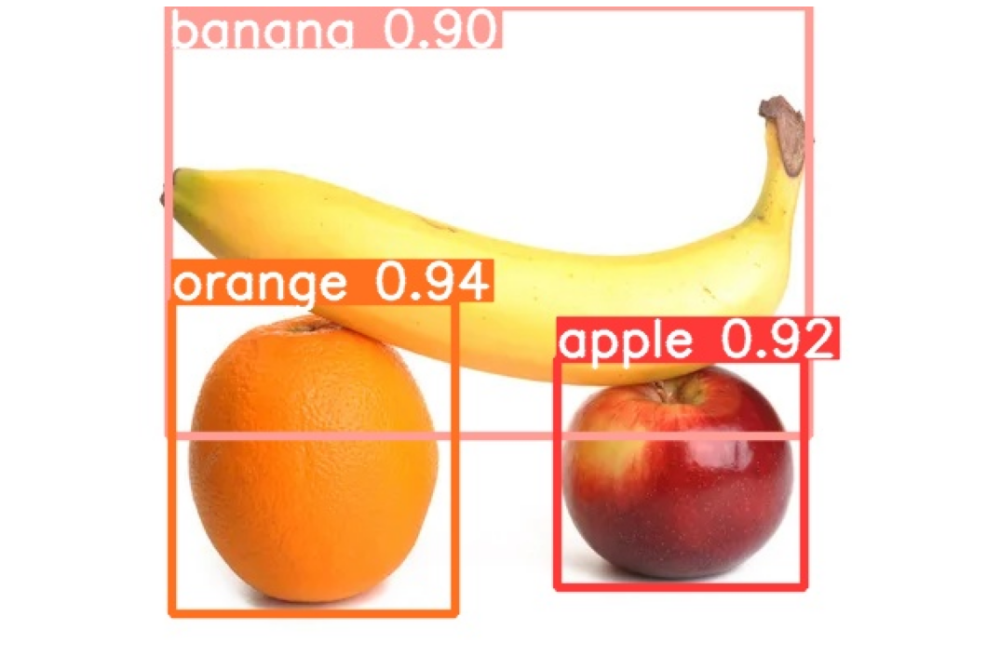

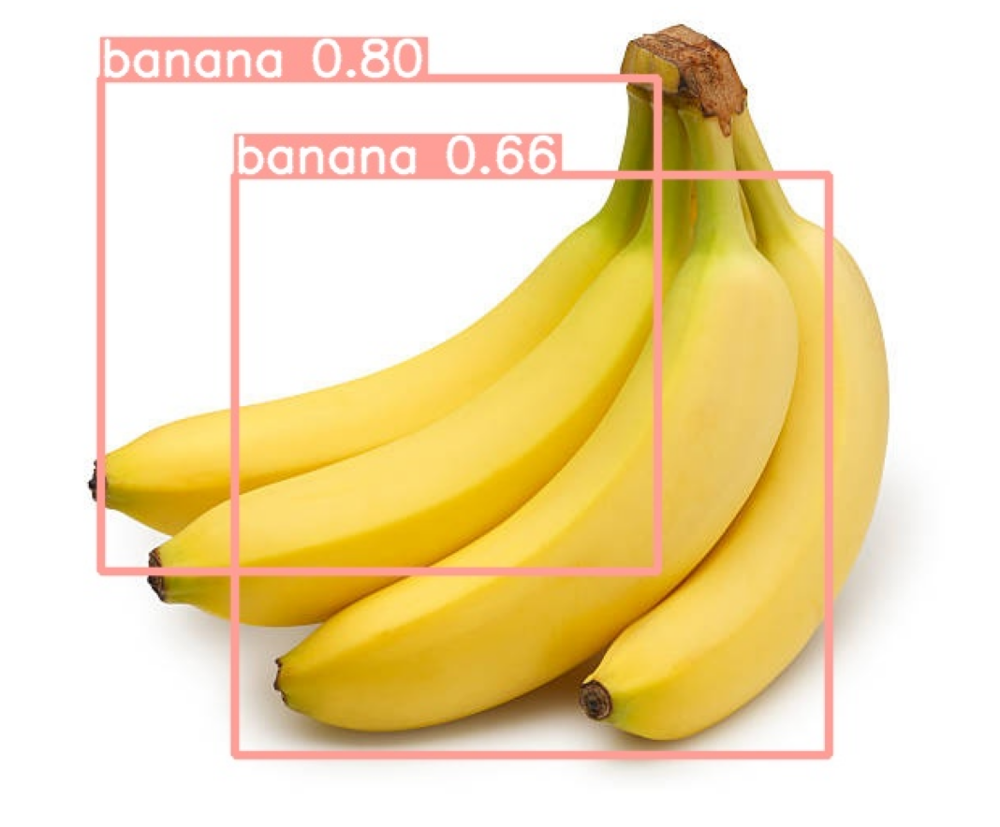

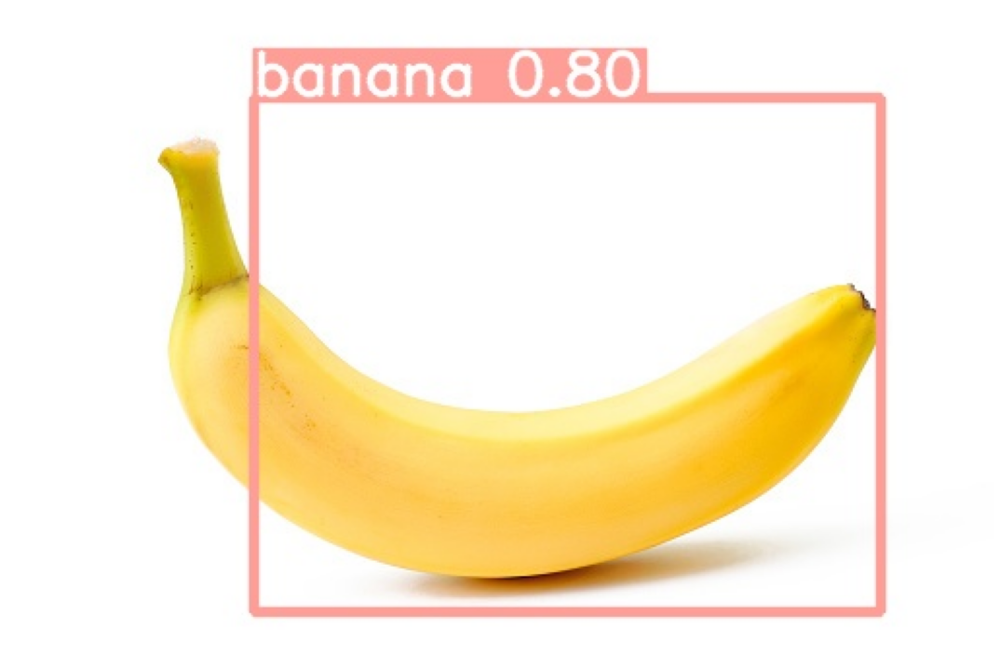

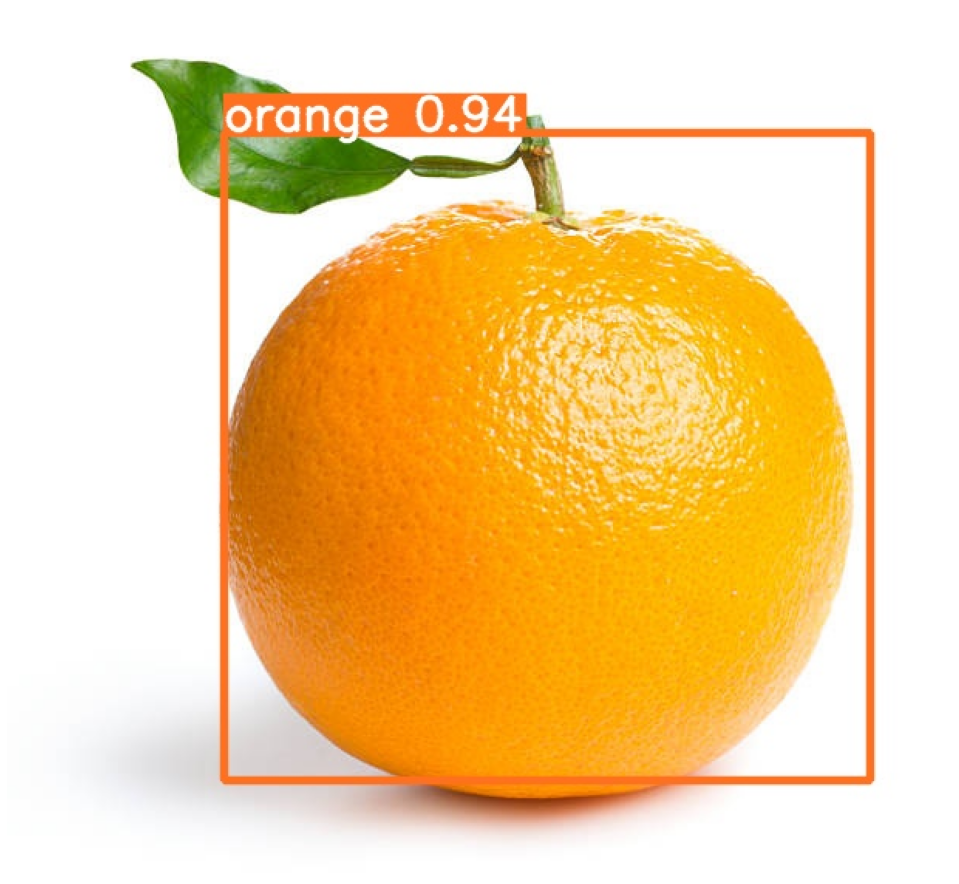

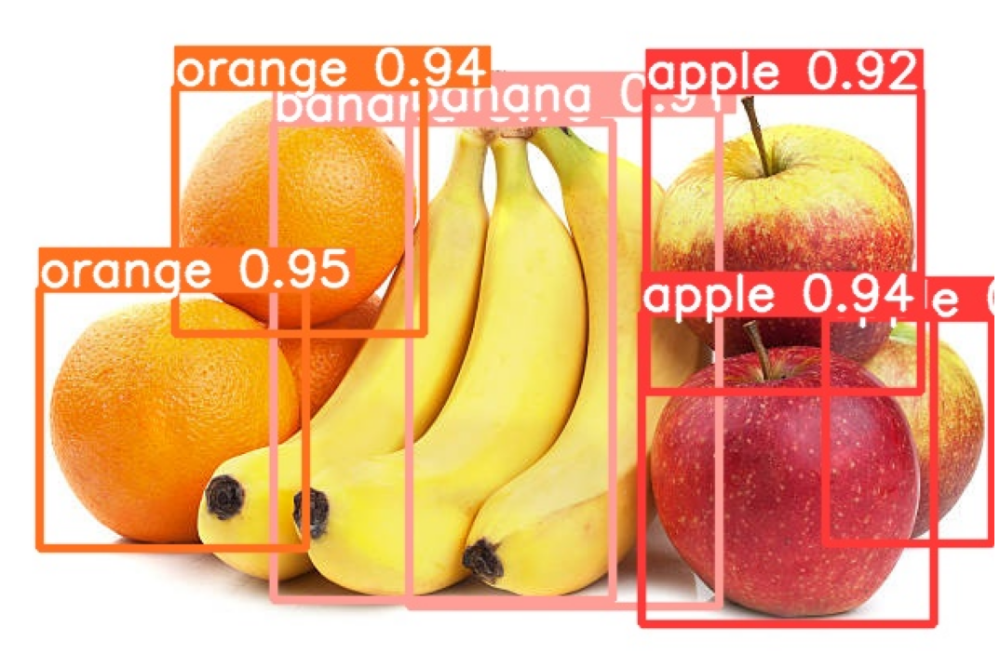

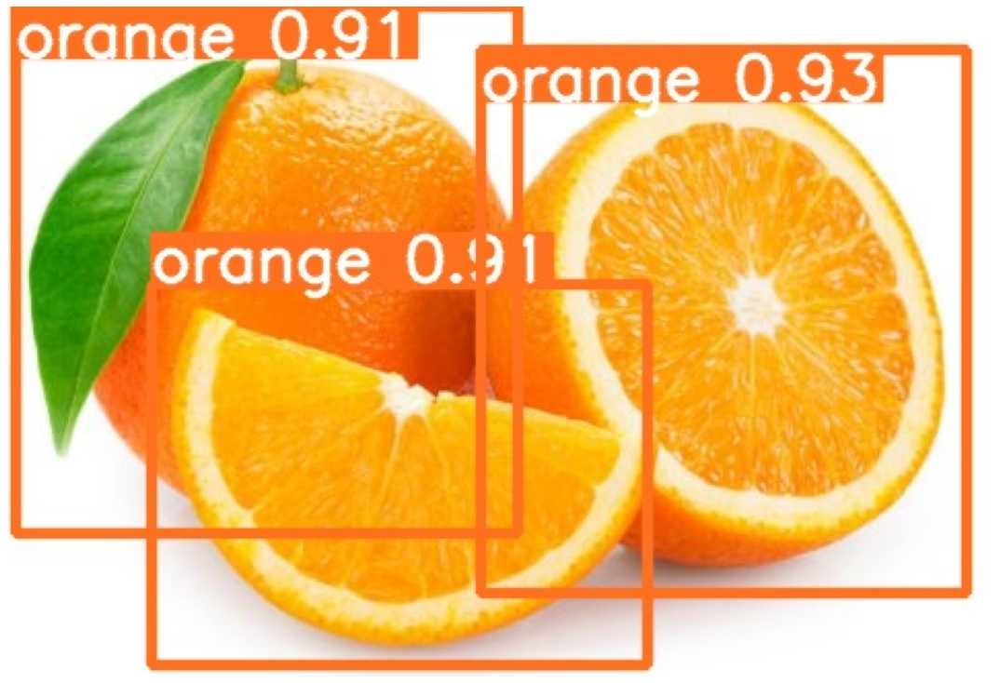

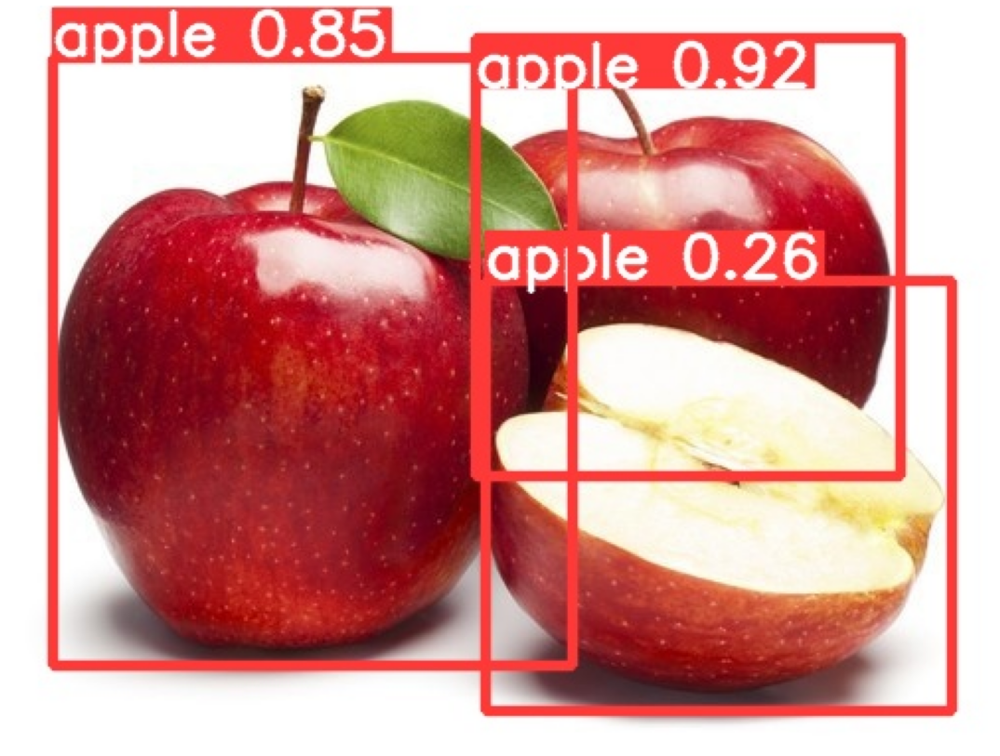

In [ ]:
visualize(IMAGE_INFER_DIR)

## Experiment 4: Data Augmentation + Finetuning yolo5m (nº frozen layers=18)

In this experiment, I used the <a href="https://app.roboflow.com/ds/w115d8mw7V?key=H7V9pu9bcS" target="_blank">Augmented Fruits</a> dataset: the aumented version of the fruits dataset. It is the same dataset as the one used in experiment 3. 

To download the dataset and get more info, please check the "Download and Prepare the Dataset" section of the Experiemnt 3.

### Training

Here, we freeze the first 18 blocks.

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 416 --epochs 500 --batch-size 16 --name {RES_DIR} \
    --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17

Current number of result directories: 1
results_2
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=500, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_2, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-359-g628c05c Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05,

In [ ]:
monitor_tensorboard()

### Visualize validation prediction images

In [ ]:
show_valid_results(RES_DIR)

### Inference on Images

In this section, we will carry out inference on the unseen images. 

To carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, '../inference')

Current number of inference detection directories: 1
inference_2
detect: weights=['runs/train/results_2/weights/best.pt'], source=../inference, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_2, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-359-g628c05c Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 290 layers, 20861016 parameters, 0 gradients, 47.9 GFLOPs
image 1/8 /content/inference/apple_test_01.jpg: 512x640 3 apples, Done. (0.023s)
image 2/8 /content/inference/apple_test_02.jpg: 544x640 1 apple, Done. (0.026s)
image 3/8 /content/inference/banana_test_01.jpg: 544x640 3 bananas, Done. (0.026s)
image 4/8 /content/inference/banana_test_02

['runs/detect/inference_2/apple_test_02.jpg', 'runs/detect/inference_2/mix_test_01.jpg', 'runs/detect/inference_2/banana_test_01.jpg', 'runs/detect/inference_2/banana_test_02.jpg', 'runs/detect/inference_2/orange_test_01.jpg', 'runs/detect/inference_2/mix_test_02.jpg', 'runs/detect/inference_2/orange_test_02.jpg', 'runs/detect/inference_2/apple_test_01.jpg']


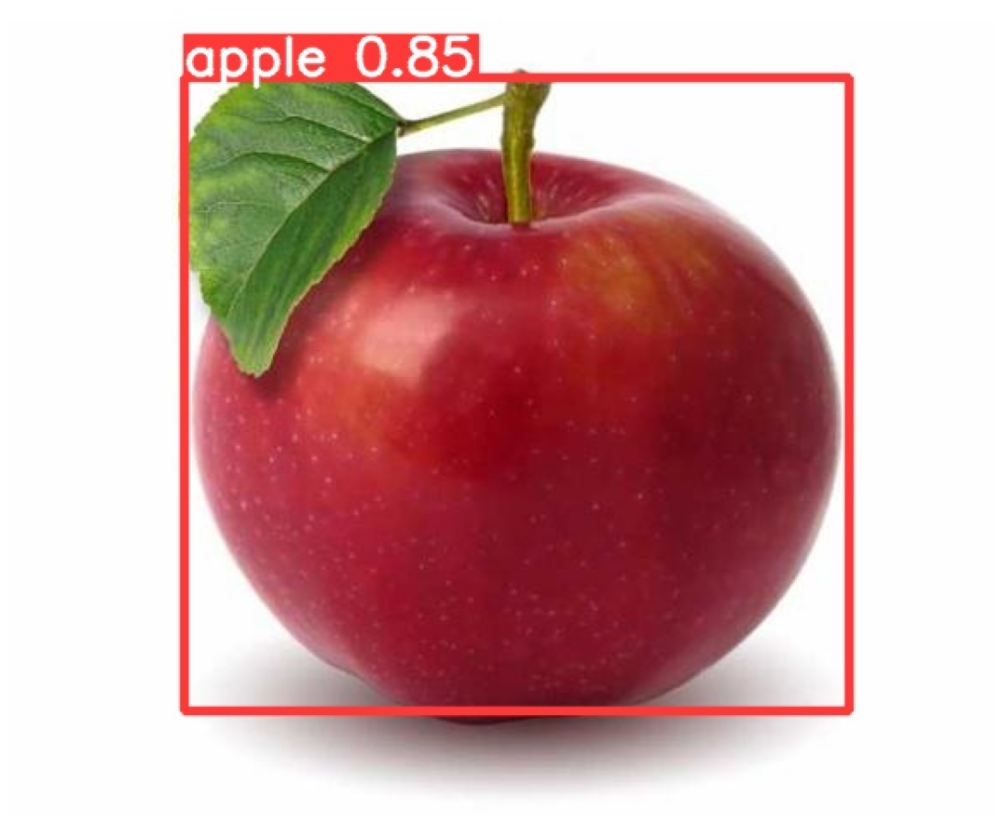

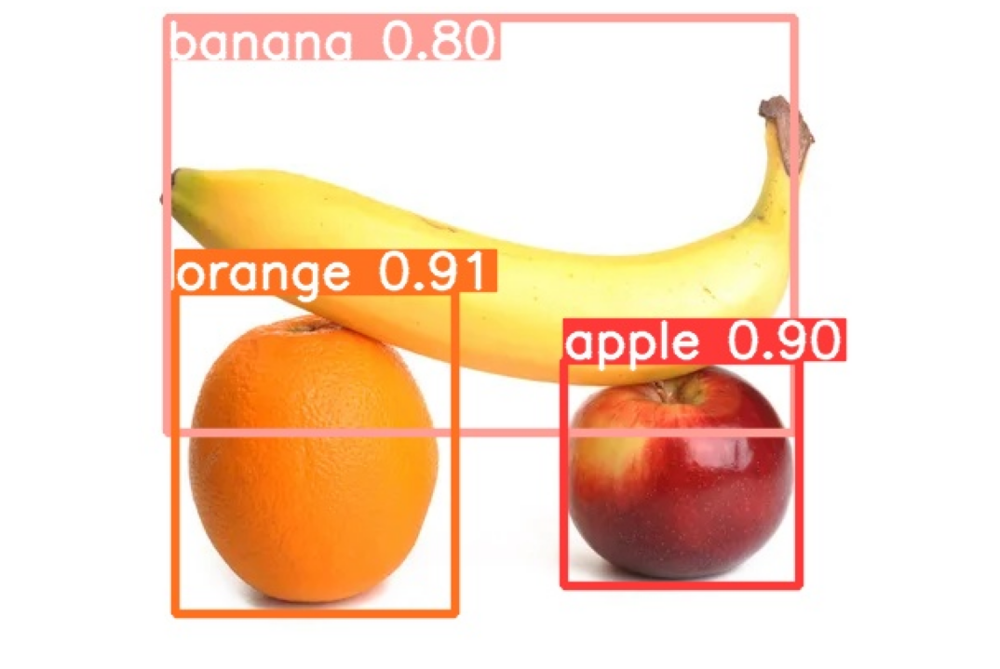

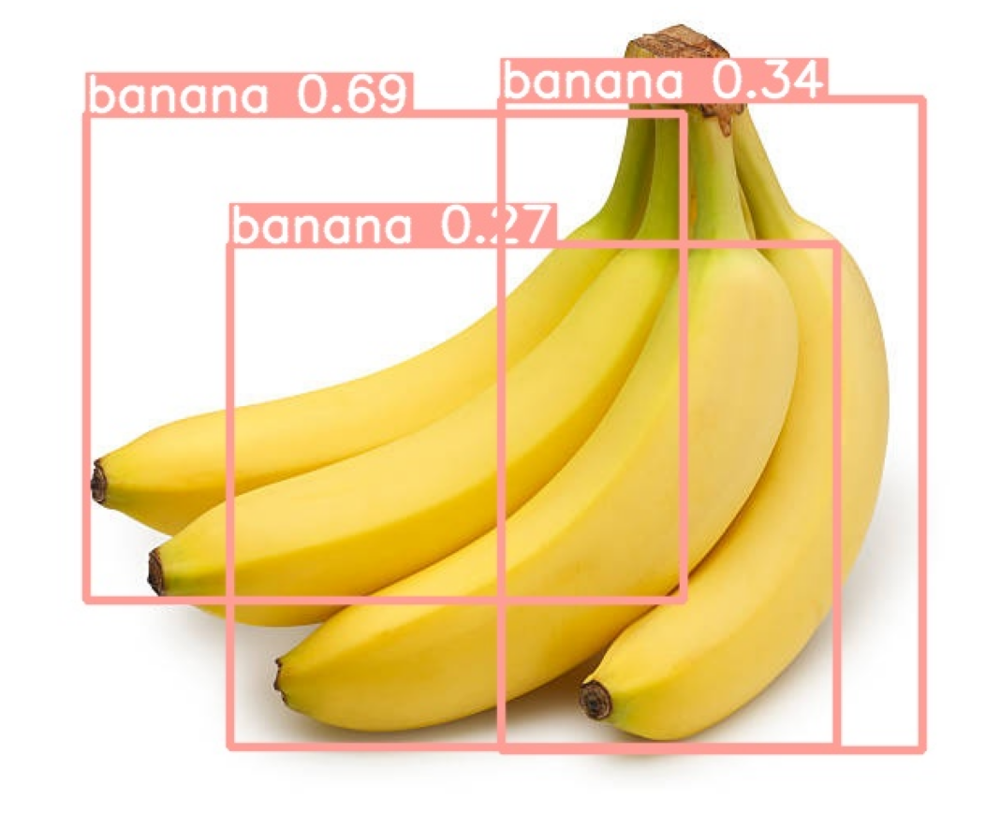

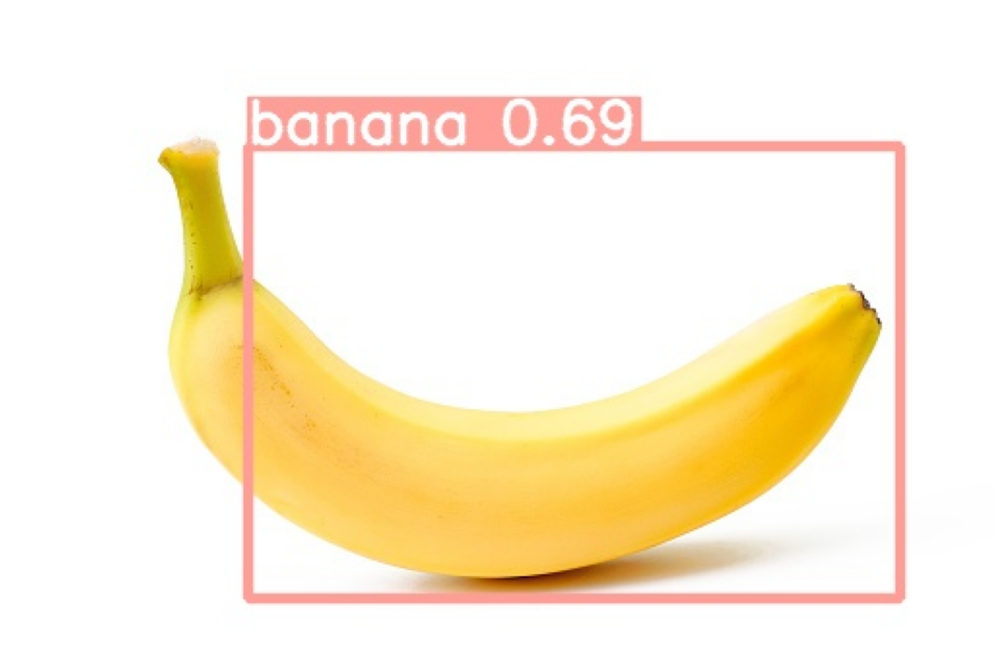

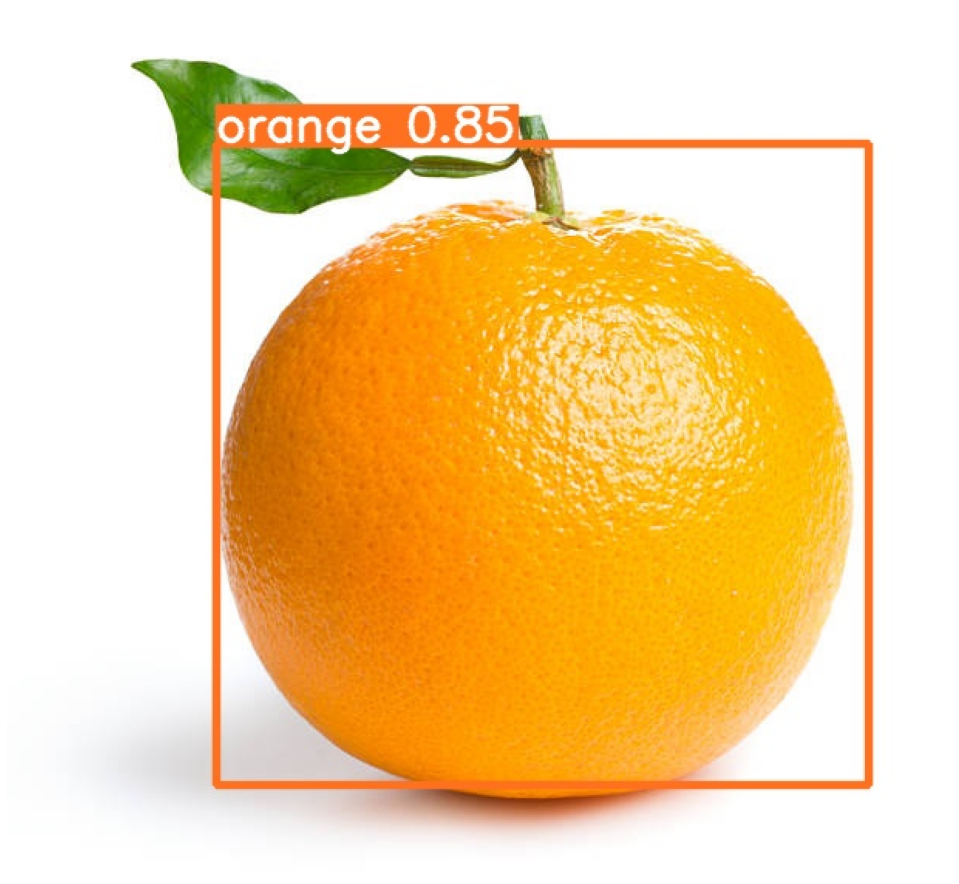

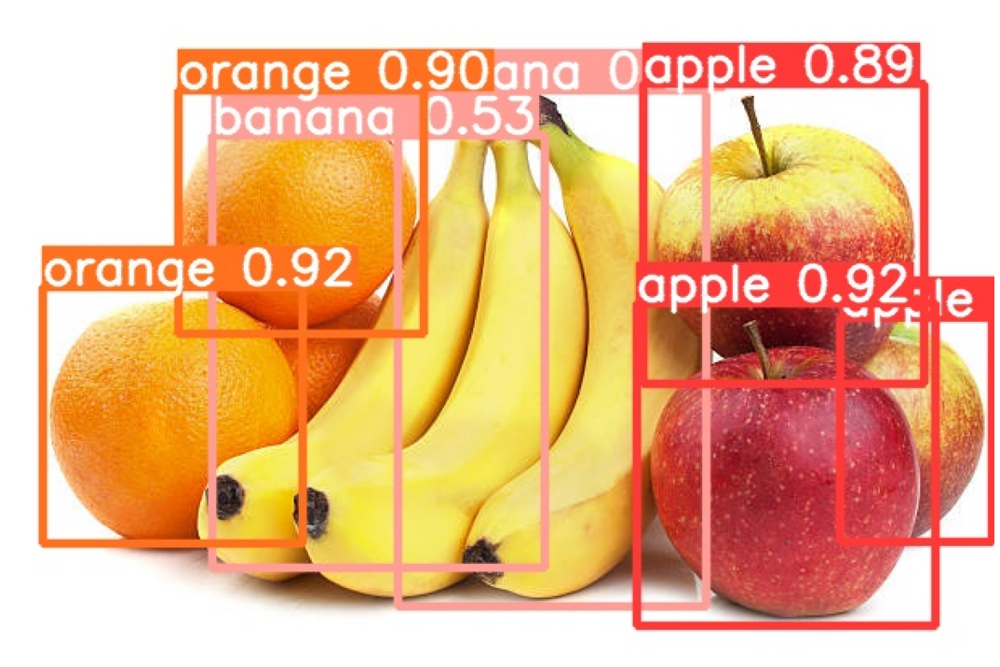

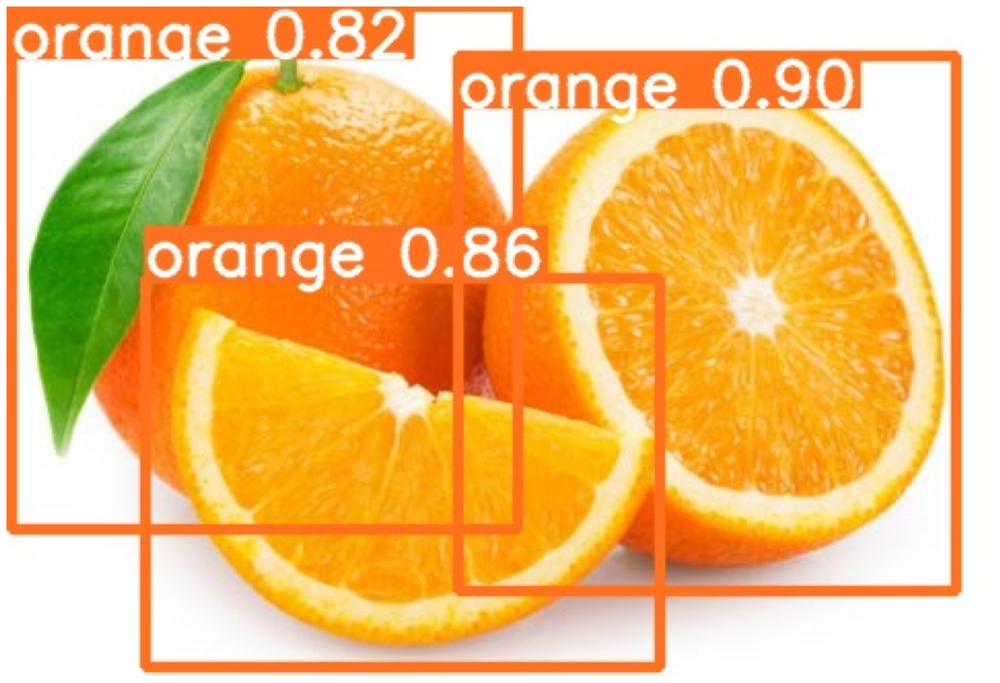

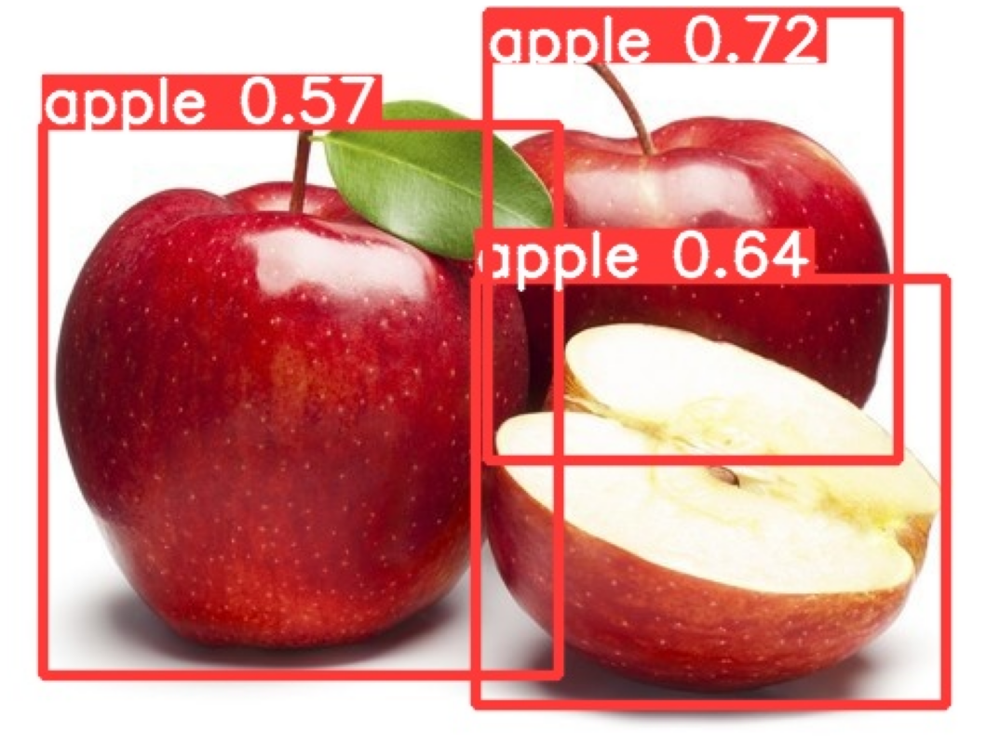

In [ ]:
visualize(IMAGE_INFER_DIR)